<a href="https://colab.research.google.com/github/AlexaChernysh/PPE_detection/blob/main/personal_protective_equipment_detection_deep_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Introduction**

#Automated Detection of Personal Protective Equipment

###Introduction
Ensuring the safety of workers in various environments, such as construction sites, factories, and laboratories, is essential. Personal Protective Equipment (PPE) such as helmets, gloves, vests, and boots are critical in minimizing the risk of injury. However, manual monitoring for compliance with PPE requirements is labor-intensive and prone to human error. This project aims to develop a deep learning-based system to automatically detect the presence of PPE in images from different environments where PPE is necessary.

###Motivation
The motivation for this project stems from the need to improve safety compliance and reduce the manual effort required to monitor PPE usage. By leveraging deep learning, we aim to create a reliable and efficient solution that can be implemented in various settings to ensure the safety of workers.




# **Objectives**

* **Develop a PPE Detection Model:** Train a Faster R-CNN  model to
accurately detect Personal Protective Equipment (PPE) such as helmets, gloves, vests, and boots in images from various environments.

* **Address the Regression Problem:** Implement regression techniques to evaluate the degree of compliance with PPE requirements in the detected images.

# **The Dataset**

The dataset used for this project is sourced from the Roboflow site, an open-source collection of images designed to facilitate deep learning projects focused on the detection of Personal Protective Equipment (PPE). This dataset contains a total of 1064 image-label pairs, specifically curated to aid in the accurate identification of various PPE items and related objects in different environments.

**Dataset Details**

The images in this dataset are labeled and categorized into the following classes:

* Boots
* Gloves
* Helmet
* Helmet on
* No boots
* No glove
* No helmet
* No vest
* Person
* Vest

**Data Split**

The dataset is divided into three primary subsets:

* Training Set: 743 images
* Testing Set: 106 images
* Validation Set: 215 images

This segmentation promotes a structured and methodical organization of the data.

In each folder there are two subfolders:
* **images:** Provided in JPG format with a resolution of 640 × 640 pixels
* **labels:** Ppe are annotated in Pascal VOC format.


## Mount Google Drive

In [ ]:
# Mount Google Drive to access files stored there
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Import Libraries and Folders

In [ ]:
# Configurations for inline plotting
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Standard libraries
import os
import xml.etree.ElementTree as ET

# Data handling and plotting libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Image processing libraries
from PIL import Image
import cv2
from google.colab.patches import cv2_imshow

# PyTorch and torchvision libraries
import torch
import torchvision
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms, models
import torchvision.transforms as T
from torchvision.transforms import functional as F
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor, TwoMLPHead

In [ ]:
folder_path = '/content/drive/My Drive/construction.v1i.voc'
for filename in os.listdir(folder_path):
    print(filename)



README.roboflow.txt
README.dataset.txt
.DS_Store
train
valid
test


#Data preparation

# Model Selection
##1. **Faster R-CNN model for PPE Detection**  
For our project, we have chosen Faster R-CNN  (Region-based Convolutional Neural Network) due to its high accuracy and robustness in object detection tasks.



 It provides:

* **High Precision:** Ensures accurate detection and localization of different PPE items.
* **Robustness:** Performs well in complex, cluttered environments.
* **Efficiency:** Faster processing with its region proposal network (RPN).
* **Versatility:** Adaptable for detecting various PPE items.

 Faster R-CNN's ability to precisely locate and classify multiple objects in complex environments makes it well-suited for detecting various types of PPE in diverse and challenging scenarios.

## Loading and configuring the pre-trained Faster R-CNN model


Initially, we started with a pre-trained Faster R-CNN model to evaluate its capabilities and performance on our data. However, it became evident that the model's predefined labels did not align with our specific needs. Therefore, we need to fine-tune the model and train it on our custom dataset to achieve accurate detection for our purposes. We leave this part of the code here to show its output and demonstrate the initial results before fine-tuning.

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


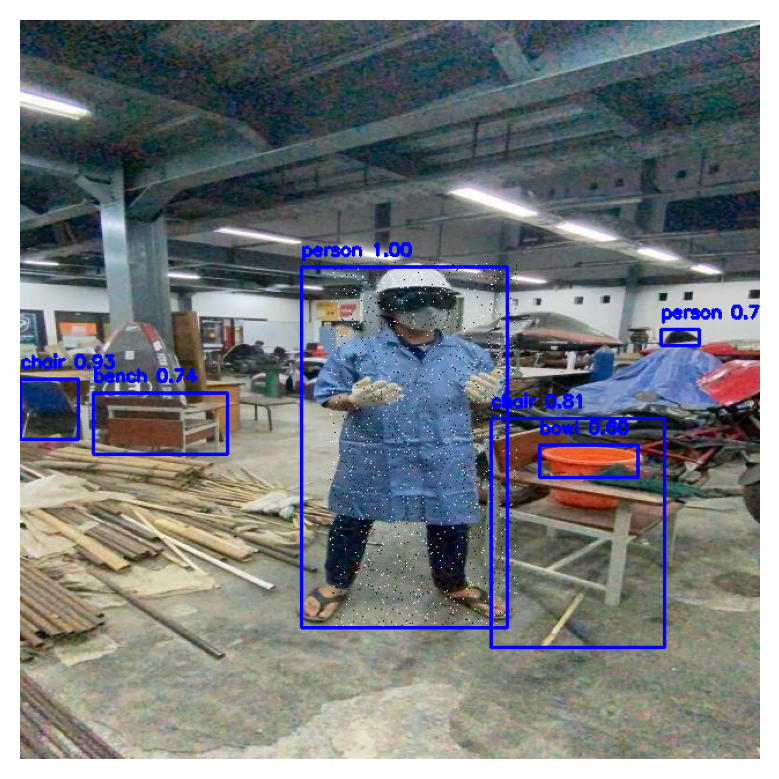

In [ ]:
# Load a pretrained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()  # Set the model to evaluation mode

# Define class names (for COCO dataset, we will modify this letter for our dataset)
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant',
    'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat',
    'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli',
    'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
    'N/A', 'dining table', 'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote',
    'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Function to predict and visualize bounding boxes on an image using Faster R-CNN
def predict(image_path, threshold=0.5):
    img = Image.open(image_path).convert("RGB")  # Open and convert image to RGB
    img_tensor = F.to_tensor(img).unsqueeze(0)  # Convert image to tensor and add batch dimension

    # Perform inference
    with torch.no_grad():
        predictions = model(img_tensor)

    img_np = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)  # Convert image to numpy array for drawing boxes
    for idx in range(len(predictions[0]['boxes'])):
        score = predictions[0]['scores'][idx]
        if score >= threshold:  # Filter predictions by score threshold
            box = predictions[0]['boxes'][idx].cpu().numpy().astype(int)
            label = predictions[0]['labels'][idx].item()
            cv2.rectangle(img_np, (box[0], box[1]), (box[2], box[3]), (255, 0, 0), 2)  # Draw bounding box
            cv2.putText(img_np, f'{COCO_INSTANCE_CATEGORY_NAMES[label]} {score:.2f}', (box[0], box[1] - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)  # Add label text

    img_rgb = cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB)  # Convert image back to RGB format for displaying
    plt.imshow(img_rgb)  # Display the image with bounding boxes
    plt.axis('off')
    plt.show()

# Example usage to predict and visualize bounding boxes on an image
image_path = '/content/drive/My Drive/construction.v1i.voc/train/59_JPG_jpg.rf.95f4a863b1bd97fead24aba556759d8f.jpg'  # Replace with your image path
predict(image_path)


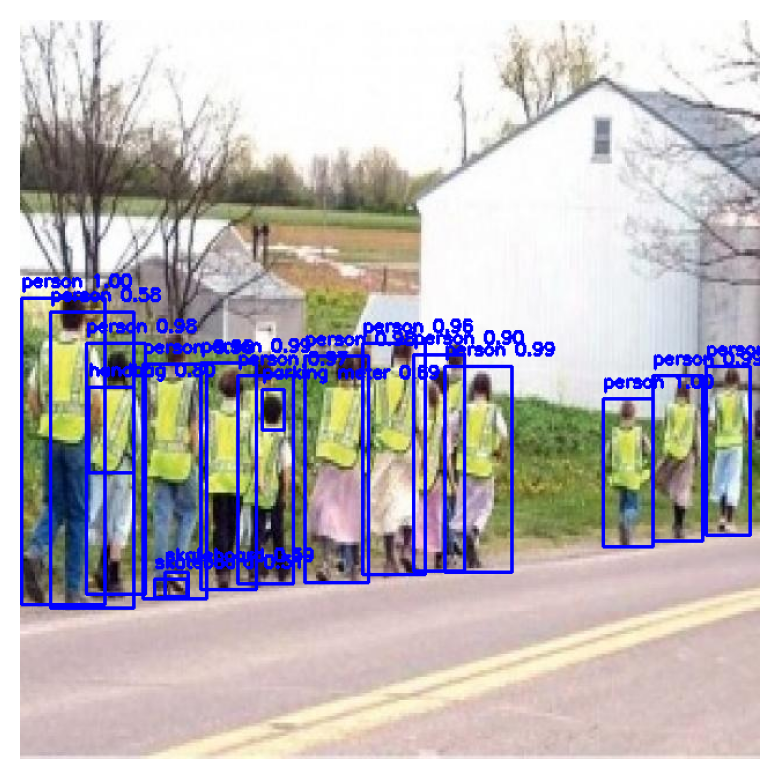

In [ ]:
# Example usage to predict and visualize bounding boxes on an image
image_path = '/content/drive/My Drive/construction.v1i.voc/train/00060_jpg.rf.af2c0538c8602d75953ee7751ccbc8ce.jpg'
predict(image_path)

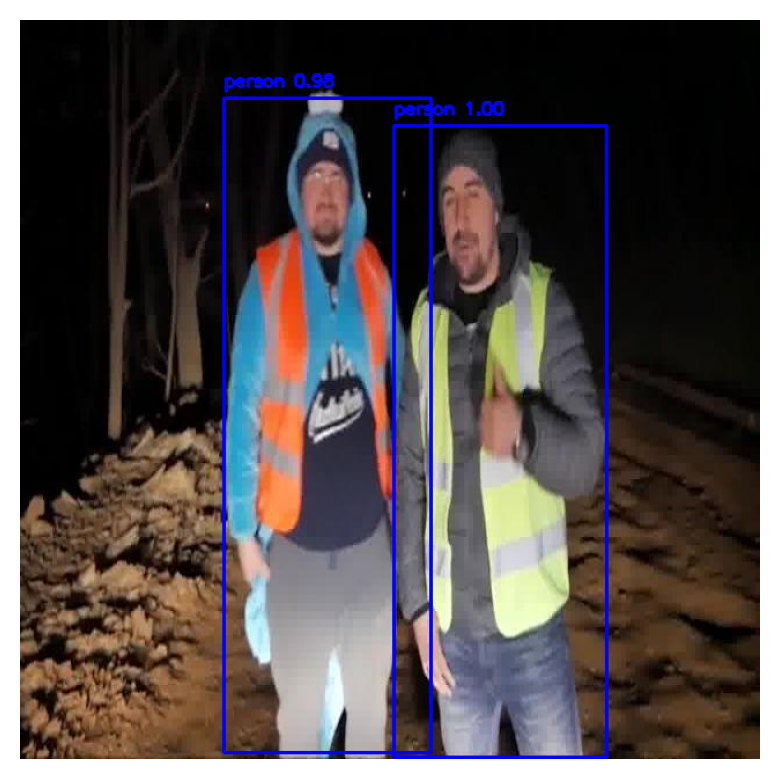

In [ ]:
# Example usage to predict and visualize bounding boxes on an image
image_path = '/content/drive/My Drive/construction.v1i.voc/train/AightSird0497_jpg.rf.99b3b4fe2d1a82247d92d50cf7cdec61.jpg'
predict(image_path)

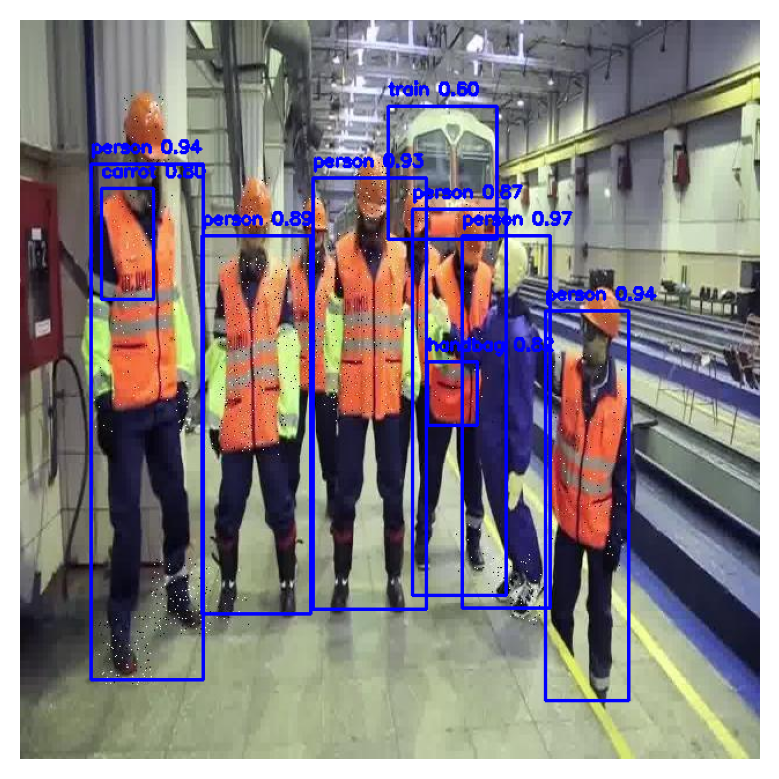

In [ ]:
# Example usage to predict and visualize bounding boxes on an image
image_path = '/content/drive/My Drive/construction.v1i.voc/train/Aitin1170_jpg.rf.5595857a5ae3053e8f7de7524e125835.jpg'
predict(image_path)

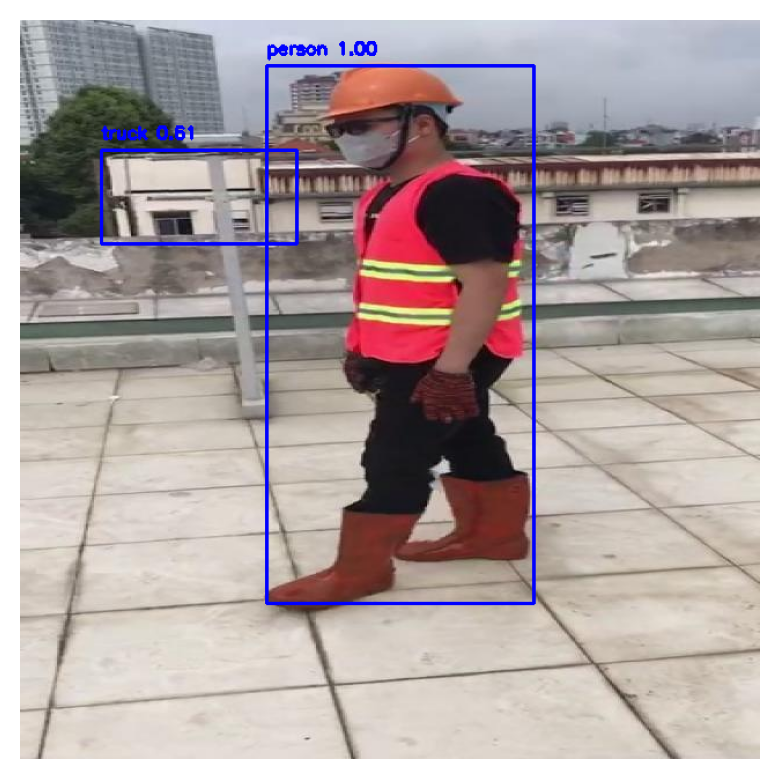

In [ ]:
# Example usage to predict and visualize bounding boxes on an image
image_path = '/content/drive/My Drive/construction.v1i.voc/valid/Video3_229_jpg.rf.deee4eb7fa5476385e1c1820626e6a6c.jpg'
predict(image_path)

iT became evident that the model's predefined labels did not align with our specific needs. Therefore, we fine-tuned the model and trained it on our custom dataset to achieve accurate detection for our purposes.

#Custom dataset

We defined a custom dataset class to handle our labeled data, applied necessary transformations, and created a DataLoader for batch processing. The custom dataset was then used to train the Faster R-CNN model with the following steps:

Load the pre-trained model.
Replace the classifier head with a new one tailored to our PPE classes.
Train the model using the custom dataset.

In [ ]:
# Define class names for our dataset
CUSTOM_CLASS_NAMES = ["__background__", "boots", "gloves", "helmet", "helmet on",
                      "no boots", "no glove", "no helmet", "no vest", "person", "vest"]

# Colors for classes (BGR format for OpenCV)
CUSTOM_CLASS_COLORS = {
    #"__background__": (255, 255, 255), # White for background
    "boots": (0, 255, 0),              # Green
    "gloves": (128, 0, 128),           # Purple
    "helmet": (0, 0, 255),             # Blue
    "helmet on": (255, 255, 0),        # Cyan
    "no boots": (255, 0, 255),         # Magenta
    "no glove": (0, 255, 255),         # Yellow
    "no helmet": (255, 0, 0),          # Red
    "no vest": (128, 128, 0),          # Olive
    "person": (0, 128, 128),           # Teal
    "vest": (255, 128, 255)            # Plum
}

In [ ]:
# Define a custom dataset class
class CustomDataset(Dataset):
    def __init__(self, root, transforms=None):
        self.root = root
        self.transforms = transforms
        self.files = list(sorted(os.listdir(root)))
        self.imgs = [f for f in self.files if f.endswith('.jpg')]
        self.labels = [f for f in self.files if f.endswith('.xml')]

    def __getitem__(self, idx):
        img_path = os.path.join(self.root, self.imgs[idx])
        label_path = img_path.replace('.jpg', '.xml')

        img = Image.open(img_path).convert("RGB")
        boxes = []
        labels = []

        tree = ET.parse(label_path)
        root = tree.getroot()

        for member in root.findall('object'):
            label = member.find('name').text
            labels.append(CUSTOM_CLASS_NAMES.index(label))
            bndbox = member.find('bndbox')
            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)
            boxes.append([xmin, ymin, xmax, ymax])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        target = {"boxes": boxes, "labels": labels}

        if self.transforms is not None:
            img = self.transforms(img)

        return img, target

    def __len__(self):
        return len(self.imgs)

In [ ]:
# Transformations for the dataset
def get_transform():
    transforms = []
    transforms.append(T.ToTensor())
    return T.Compose(transforms)

# Load the custom dataset
dataset = CustomDataset(root='/content/drive/My Drive/construction.v1i.voc/train', transforms=get_transform())
data_loader = DataLoader(dataset, batch_size=2, shuffle=True, num_workers=2, collate_fn=lambda x: tuple(zip(*x)))



In [ ]:
# Load a pretrained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
num_classes = len(CUSTOM_CLASS_NAMES)  # Including the background class

# Get the number of input features for the classifier
in_features = model.roi_heads.box_predictor.cls_score.in_features

# Replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

In [ ]:
##DO NOT RUN##
import torch

# Training function
def train_model(model, data_loader, device, num_epochs=20, learning_rate=0.005):
    model.to(device)
    params = [p for p in model.parameters() if p.requires_grad]
    optimizer = torch.optim.SGD(params, lr=learning_rate, momentum=0.9, weight_decay=0.0005)

    for epoch in range(num_epochs):
        model.train()
        for images, targets in data_loader:
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

            optimizer.zero_grad()
            losses.backward()
            optimizer.step()


        print(f'Epoch {epoch+1}, Loss: {losses.item()}')

# Define device
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

train_model(model, data_loader, device, num_epochs=20)

Epoch 1, Loss: 0.6236612796783447
Epoch 2, Loss: 0.7174540758132935
Epoch 3, Loss: 0.6393451690673828
Epoch 4, Loss: 0.5398478507995605
Epoch 5, Loss: 0.25698262453079224
Epoch 6, Loss: 0.5604206323623657
Epoch 7, Loss: 0.29277265071868896
Epoch 8, Loss: 0.3160339593887329
Epoch 9, Loss: 0.2417183369398117
Epoch 10, Loss: 0.35884392261505127
Epoch 11, Loss: 0.03946384787559509
Epoch 12, Loss: 0.10210050642490387
Epoch 13, Loss: 0.2787199020385742
Epoch 14, Loss: 0.3990396559238434
Epoch 15, Loss: 0.19086888432502747
Epoch 16, Loss: 0.19188012182712555
Epoch 17, Loss: 0.20855924487113953
Epoch 18, Loss: 0.3355989456176758
Epoch 19, Loss: 0.167961984872818
Epoch 20, Loss: 0.18865667283535004


In [ ]:
##DO NOT RUN##

# Training function
def train_model(model, data_loader, device, num_epochs=10, learning_rate=0.005):
    model.to(device)
    params = [p for p in model.parameters() if p.requires_grad]
    optimizer = torch.optim.SGD(params, lr=learning_rate, momentum=0.9, weight_decay=0.0005)

    for epoch in range(num_epochs):
        model.train()
        for images, targets in data_loader:
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

            optimizer.zero_grad()
            losses.backward()
            optimizer.step()


        print(f'Epoch {epoch+1}, Loss: {losses.item()}')

        if losses.item() < 0.1:
            break

# Define device
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

train_model(model, data_loader, device, num_epochs=20)

KeyboardInterrupt: 

In [ ]:
# Define device
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

In [ ]:
##DO NOT RUN##
torch.save(model.state_dict(), '/content/drive/MyDrive/ppe_detection_model.pth')

In [ ]:
#import torch
#from torchvision import models
# Define the model
model = models.detection.fasterrcnn_resnet50_fpn(pretrained=False, num_classes=11)
# Load the trained model weights
model.load_state_dict(torch.load('/content/drive/MyDrive/ppe_detection_model.pth'))
# Set the model to evaluation mode
model.eval()
print("Model loaded and set to evaluation mode on device:", device)


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Model loaded and set to evaluation mode on device: cuda


In [ ]:
def evaluate_model(model, data_loader, device):
    model.to(device)
    model.eval()
    results = []
    with torch.no_grad():
        for images, targets in data_loader:
            images = list(image.to(device) for image in images)
            outputs = model(images)
            results.extend(outputs)
    return results

# Load the valid dataset
valid_dataset = CustomDataset(root='/content/drive/My Drive/construction.v1i.voc/valid', transforms=get_transform())
valid_data_loader = DataLoader(valid_dataset, batch_size=2, shuffle=False, num_workers=2, collate_fn=lambda x: tuple(zip(*x)))

# Evaluate the model
valid_results = evaluate_model(model, valid_data_loader, device)

#Prediction

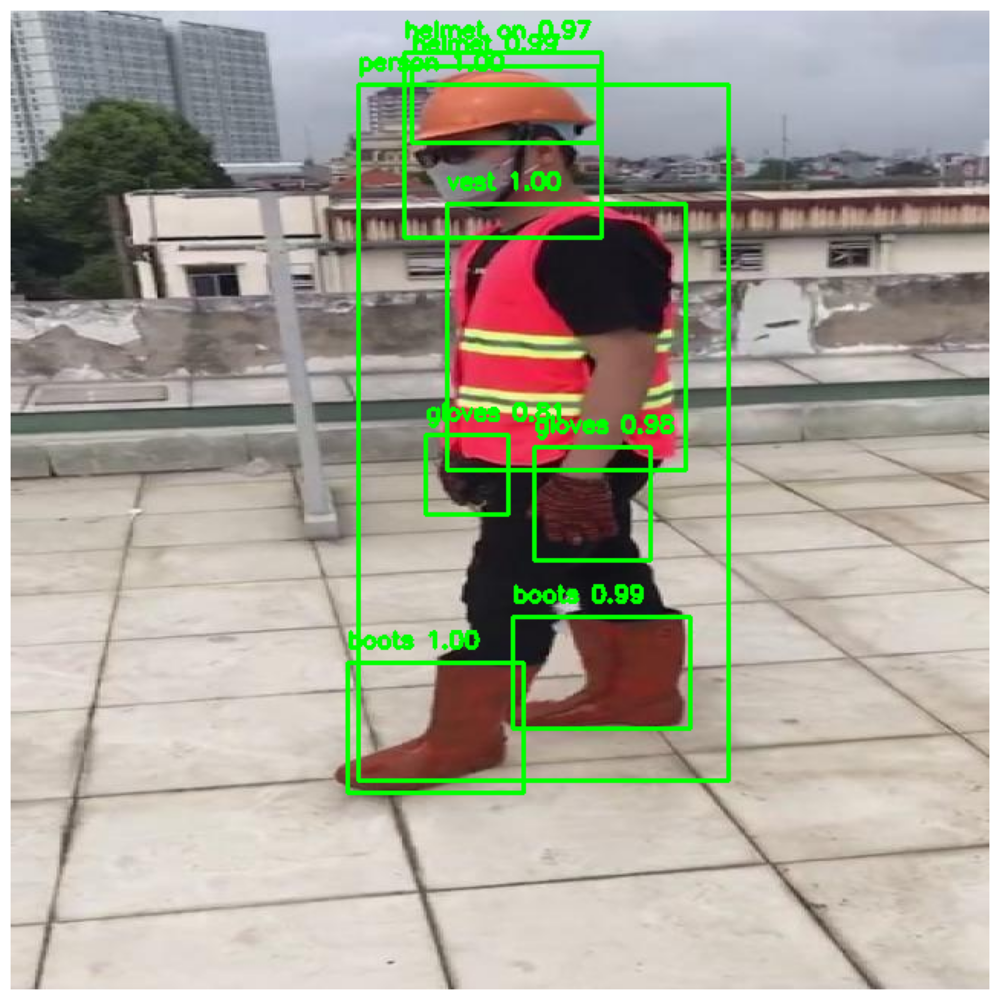

In [ ]:
def predict(image_path, model, device):
    model.eval()
    img = Image.open(image_path).convert("RGB")
    transform = get_transform()
    img = transform(img).unsqueeze(0).to(device)

    with torch.no_grad():
        prediction = model(img)

    return prediction

# Example usage
image_path = '/content/drive/My Drive/construction.v1i.voc/valid/Video3_229_jpg.rf.deee4eb7fa5476385e1c1820626e6a6c.jpg'
model.load_state_dict(torch.load('/content/drive/MyDrive/ppe_detection_model.pth'))
prediction = predict(image_path, model, device)

# Post-process and visualize the prediction
def plot_prediction(image_path, prediction, threshold=0.5):
    img = cv2.imread(image_path)
    prediction = prediction[0]
    boxes = prediction['boxes'].cpu().numpy()
    labels = prediction['labels'].cpu().numpy()
    scores = prediction['scores'].cpu().numpy()

    for box, label, score in zip(boxes, labels, scores):
        if score >= threshold:
            xmin, ymin, xmax, ymax = map(int, box)
            class_name = CUSTOM_CLASS_NAMES[label]
            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)
            cv2.putText(img, f'{class_name} {score:.2f}', (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    plt.figure(figsize=(12, 12))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

image_path = '/content/drive/My Drive/construction.v1i.voc/valid/Video3_229_jpg.rf.deee4eb7fa5476385e1c1820626e6a6c.jpg'
prediction = predict(image_path, model, device)

plot_prediction(image_path, prediction)



#Visualization

We visualized the model's predictions on sample images to qualitatively assess its performance. The bounding boxes, labels, and confidence scores were plotted on the images to demonstrate the model's detection capabilities.

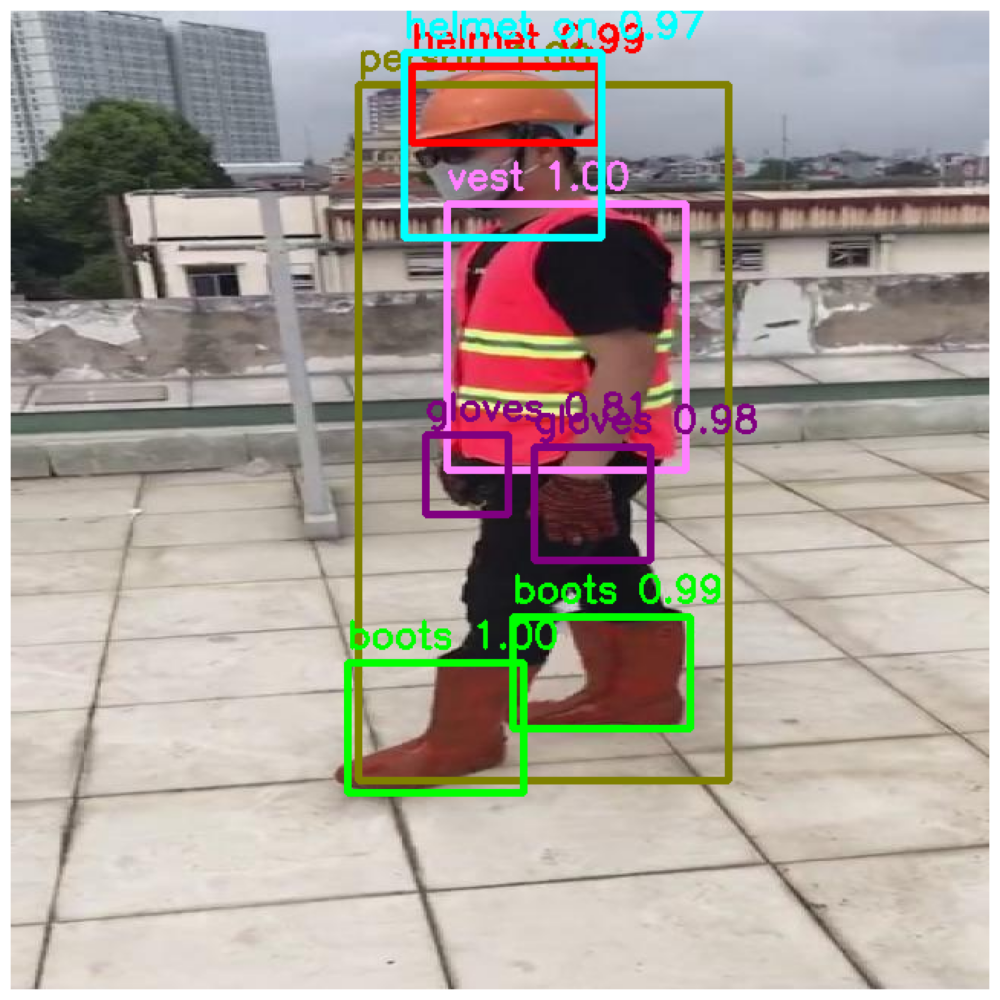

In [ ]:
def plot_prediction(image_path, prediction, threshold=0.5):
    img = cv2.imread(image_path)
    prediction = prediction[0]
    boxes = prediction['boxes'].cpu().numpy()
    labels = prediction['labels'].cpu().numpy()
    scores = prediction['scores'].cpu().numpy()

    for box, label, score in zip(boxes, labels, scores):
        if score >= threshold:
            xmin, ymin, xmax, ymax = map(int, box)
            class_name = CUSTOM_CLASS_NAMES[label]
            color = CUSTOM_CLASS_COLORS.get(class_name, (255, 255, 255))  # Default to white if class not found
            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), color, 4)
            cv2.putText(img, f'{class_name} {score:.2f}', (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2)

    plt.figure(figsize=(12, 12))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# Example usage
image_path = '/content/drive/My Drive/construction.v1i.voc/valid/Video3_229_jpg.rf.deee4eb7fa5476385e1c1820626e6a6c.jpg'
model.load_state_dict(torch.load('/content/drive/MyDrive/ppe_detection_model.pth'))
prediction = predict(image_path, model, device)

plot_prediction(image_path, prediction)

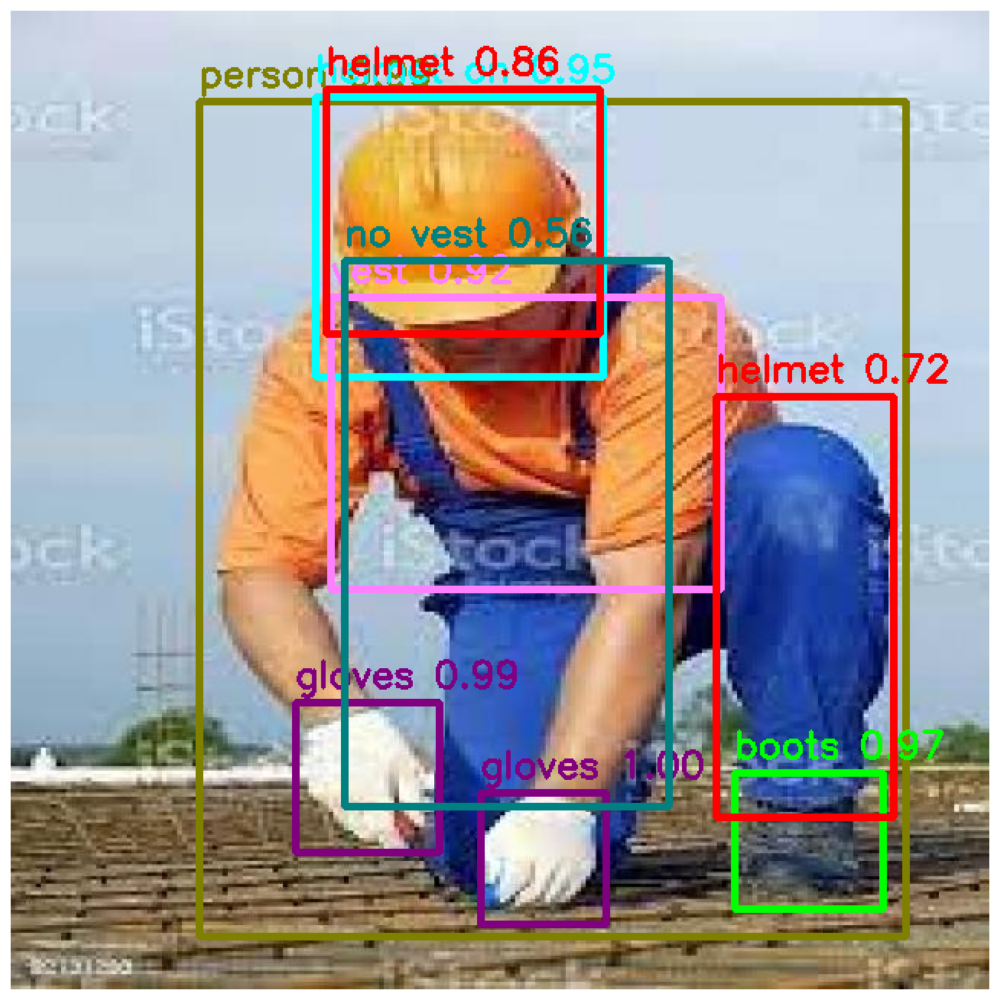

In [ ]:
# Example usage
image_path = '/content/drive/My Drive/construction.v1i.voc/test/download-3-_jpeg_jpg.rf.8574340e57594a09f4464feebe98be63.jpg'
prediction = predict(image_path, model, device)

plot_prediction(image_path, prediction)

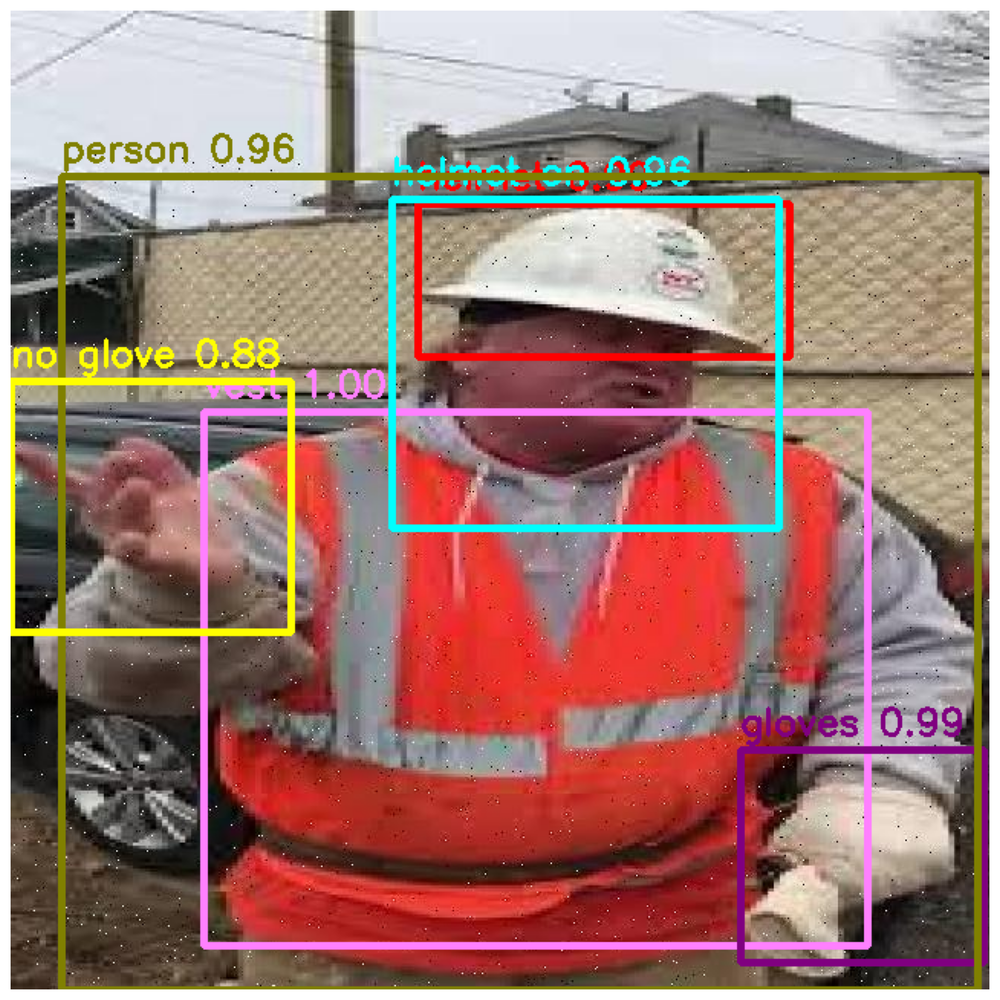

In [ ]:
# Example usage
image_path = '/content/drive/My Drive/construction.v1i.voc/valid/images85_jpg.rf.21395f614e6b9d20bc8c51bfc32dca38.jpg'
prediction = predict(image_path, model, device)

plot_prediction(image_path, prediction)

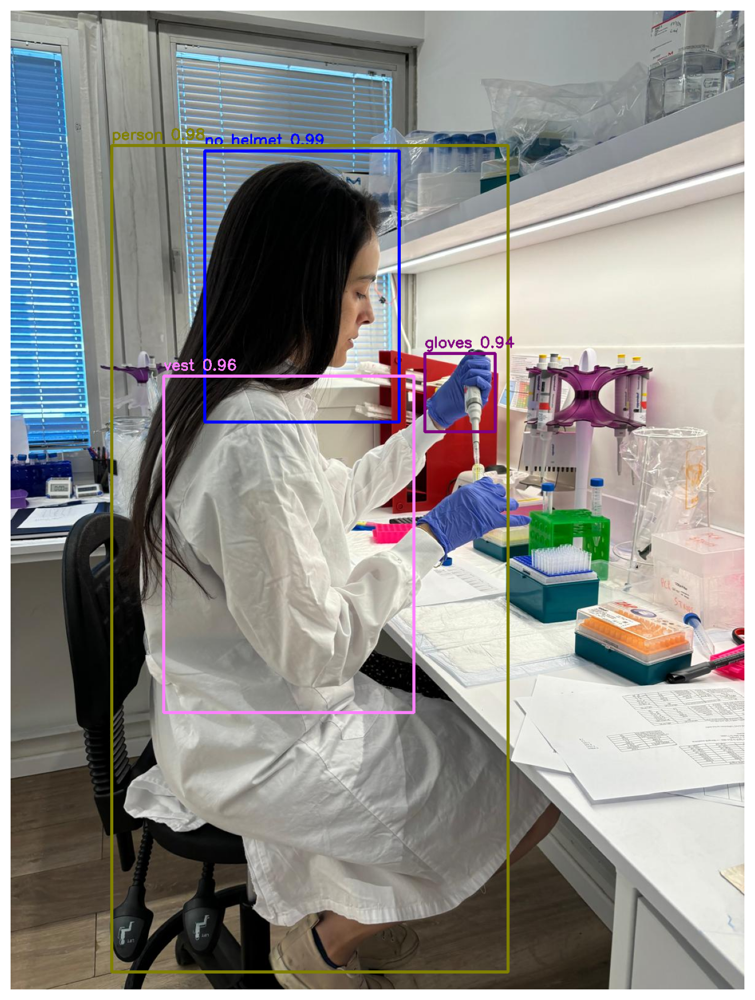

In [ ]:
# Example usage
image_path = '/content/drive/My Drive/Adi.jpg'
prediction = predict(image_path, model, device)

plot_prediction(image_path, prediction)

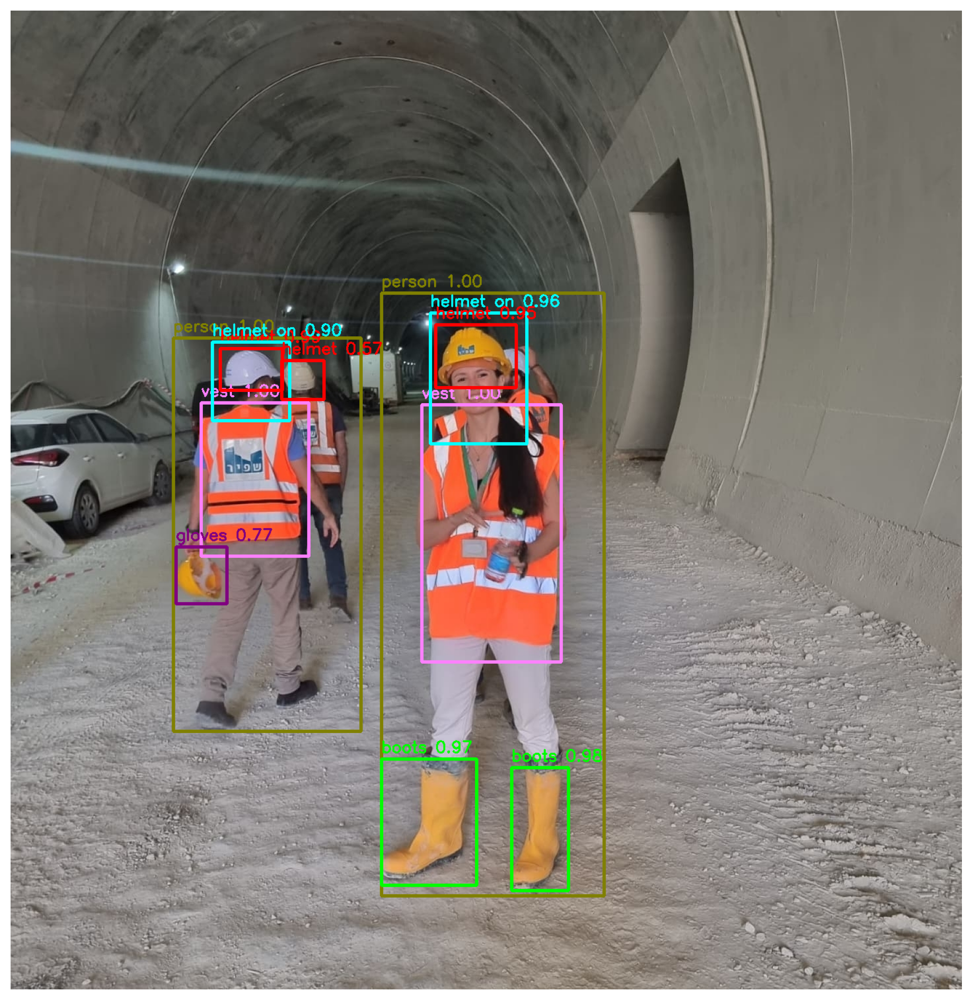

In [ ]:
# Example usage
image_path = '/content/drive/My Drive/alex11.jpg'
prediction = predict(image_path, model, device)

plot_prediction(image_path, prediction)

Handling Double Detections.


Whenever double bounding boxes appeared in the same area for "Helmet" and "Helmet On," we wrote a loop to skip double detection in the same area. This step helps to reduce the noisy information that appears multiple times in the same area, improving the visual clarity and model's accuracy for these classes.

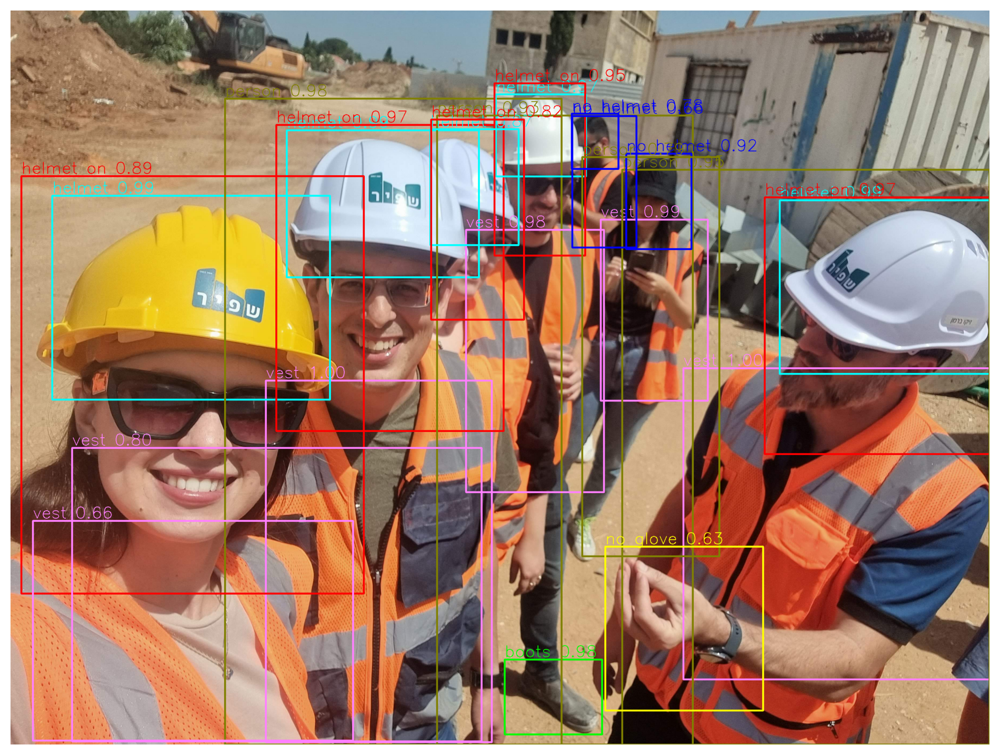

In [ ]:

# Example usage
image_path = '/content/drive/My Drive/Alexa.jpg'
prediction = predict(image_path, model, device)

plot_prediction(image_path, prediction)

 Skip "helmet" if "helmet on" is detected in the same area.

  Whenever double bounding boxes appeared in the same area for "Helmet" and "Helmet On," we wrote a loop to skip double detection in the same area. This step helps to reduce misclassification and improve the model's accuracy for these classes by ensuring that only one detection is considered in overlapping regions.

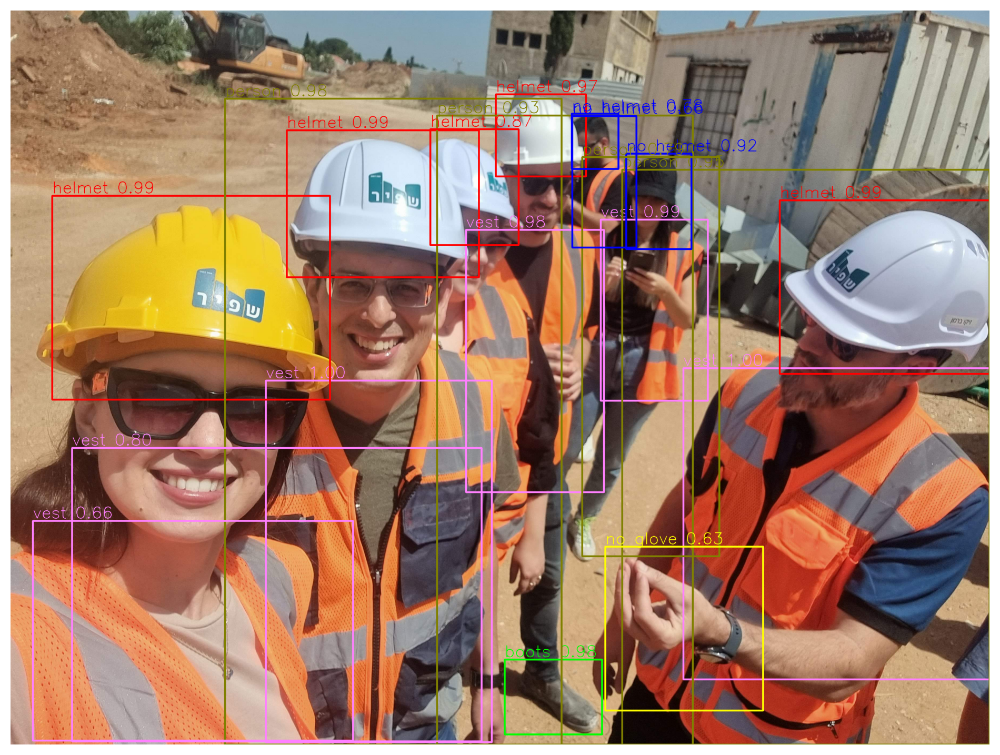

In [ ]:
def plot_prediction(image_path, prediction, threshold=0.5):
    img = cv2.imread(image_path)
    prediction = prediction[0]
    boxes = prediction['boxes'].cpu().numpy()
    labels = prediction['labels'].cpu().numpy()
    scores = prediction['scores'].cpu().numpy()

    detected_helmet_on = []

    for box, label, score in zip(boxes, labels, scores):
        if score >= threshold:
            xmin, ymin, xmax, ymax = map(int, box)
            class_name = CUSTOM_CLASS_NAMES[label]

            # Skip "helmet" if "helmet on" is detected in the same area
            if class_name == "helmet on":
                detected_helmet_on.append((xmin, ymin, xmax, ymax))
                continue  # Continue to the next box as we want to skip drawing "helmet on" as "helmet"

            if class_name == "helmet":
                skip = False
                for (hxmin, hymin, hxmax, hymax) in detected_helmet_on:
                    if (xmin >= hxmin and ymin >= hymin and xmax <= hxmax and ymax <= hymax):
                        skip = True
                        break
                if skip:
                    continue

            color = CUSTOM_CLASS_COLORS.get(class_name, (255, 255, 255))  # Default to white if class not found
            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), color, 6)
            cv2.putText(img, f'{class_name} {score:.2f}', (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 2, color, 2)

    plt.figure(figsize=(12, 12))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# Load model and set device
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.load_state_dict(torch.load('/content/drive/MyDrive/ppe_detection_model.pth', map_location=device))

# Example usage
image_path = '/content/drive/My Drive/Alexa.jpg'
prediction = predict(image_path, model, device)

plot_prediction(image_path, prediction)

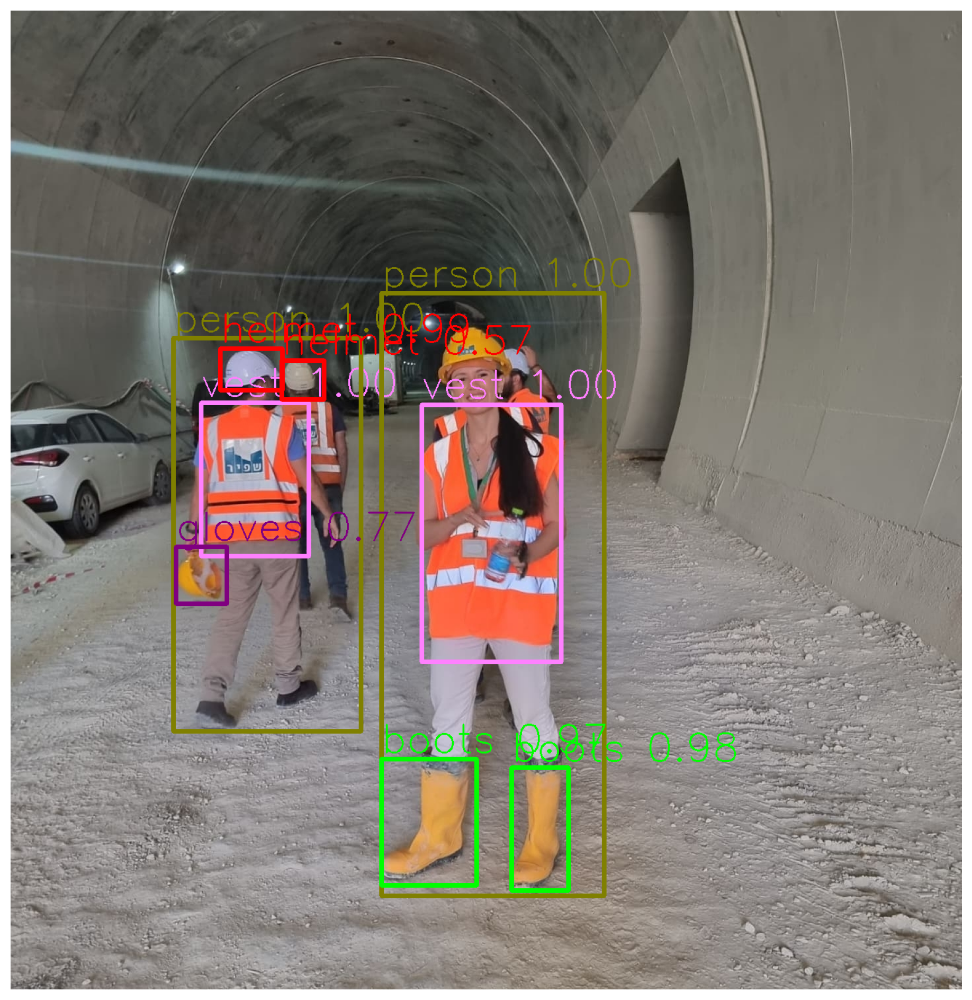

In [ ]:
# Example usage
image_path = '/content/drive/My Drive/alex11.jpg'
prediction = predict(image_path, model, device)

plot_prediction(image_path, prediction)

This step helps to reduce the noisy information that appears multiple times in the same area, improving the visual clarity.

#Evaluation of the model

We evaluated the trained model using the validation dataset and calculated key metrics, including precision and recall for each class. Additionally, we generated and analyzed a confusion matrix to understand the classifier's performance better.

In [ ]:
import pandas as pd

def get_ground_truth_and_predictions(data_loader, model, device, threshold=0.5):
    model.eval()
    ground_truths = []
    predictions = []

    with torch.no_grad():
        for images, targets in data_loader:
            images = list(image.to(device) for image in images)
            outputs = model(images)

            for target, output in zip(targets, outputs):
                gt_boxes = target['boxes'].cpu().numpy()
                gt_labels = target['labels'].cpu().numpy()

                pred_boxes = output['boxes'].cpu().numpy()
                pred_labels = output['labels'].cpu().numpy()
                pred_scores = output['scores'].cpu().numpy()

                # Filter predictions by score threshold
                keep = pred_scores >= threshold
                pred_boxes = pred_boxes[keep]
                pred_labels = pred_labels[keep]
                pred_scores = pred_scores[keep]

                ground_truths.append({'boxes': gt_boxes, 'labels': gt_labels})
                predictions.append({'boxes': pred_boxes, 'labels': pred_labels, 'scores': pred_scores})

    return ground_truths, predictions

# Get ground truth and predictions
ground_truths, predictions = get_ground_truth_and_predictions(valid_data_loader, model, device)


In [ ]:
def compare_results(ground_truths, predictions, class_names):
    comparison_results = []

    for gt, pred in zip(ground_truths, predictions):
        gt_boxes = gt['boxes']
        gt_labels = gt['labels']
        pred_boxes = pred['boxes']
        pred_labels = pred['labels']
        pred_scores = pred['scores']

        for gt_box, gt_label in zip(gt_boxes, gt_labels):
            comparison_entry = {
                'gt_label': class_names[gt_label],
                'gt_box': gt_box,
                'pred_label': None,
                'pred_box': None,
                'pred_score': None,
                'correct': False
            }

            for pred_box, pred_label, pred_score in zip(pred_boxes, pred_labels, pred_scores):
                # Check for overlap (IoU) between ground truth and prediction (simple check for this example)
                iou = calculate_iou(gt_box, pred_box)
                if iou > 0.5:  # IoU threshold
                    comparison_entry['pred_label'] = class_names[pred_label]
                    comparison_entry['pred_box'] = pred_box
                    comparison_entry['pred_score'] = pred_score
                    comparison_entry['correct'] = (gt_label == pred_label)
                    break

            comparison_results.append(comparison_entry)

    return comparison_results

def calculate_iou(box1, box2):
    # Calculate Intersection over Union (IoU) for two boxes
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])

    inter_area = max(0, x2 - x1 + 1) * max(0, y2 - y1 + 1)

    box1_area = (box1[2] - box1[0] + 1) * (box1[3] - box1[1] + 1)
    box2_area = (box2[2] - box2[0] + 1) * (box2[3] - box2[1] + 1)

    iou = inter_area / float(box1_area + box2_area - inter_area)
    return iou

# Compare results
comparison_results = compare_results(ground_truths, predictions, CUSTOM_CLASS_NAMES)


In [ ]:
# Create a pandas DataFrame to display the results
df = pd.DataFrame(comparison_results)

# Optionally, save the table to a CSV file
df.to_csv('comparison_results.csv', index=False)


In [ ]:
df[['gt_label', 'pred_label', 'pred_score', 'correct']]

,gt_label,pred_label,pred_score,correct
0,vest,vest,0.996140,True
1,vest,vest,0.994467,True
2,helmet,None,NaN,False
3,vest,vest,0.943875,True
4,vest,vest,0.987740,True
...,...,...,...,...
1679,helmet on,helmet on,0.967139,True
1680,vest,vest,0.998491,True
1681,helmet,helmet,0.971425,True
1682,person,person,0.974466,True


Accuracy Of The Model

In [ ]:
accuracy = sum(df['correct']) / len(df)
print(f'Accuracy: {accuracy:.2%}')

Accuracy: 80.23%


In [ ]:
from collections import defaultdict
def calculate_tp_fp_fn(ground_truths, predictions, class_names, iou_threshold=0.5):
    tp = defaultdict(int)
    fp = defaultdict(int)
    fn = defaultdict(int)

    for gt, pred in zip(ground_truths, predictions):
        gt_boxes = gt['boxes']
        gt_labels = gt['labels']
        pred_boxes = pred['boxes']
        pred_labels = pred['labels']
        pred_scores = pred['scores']

        # Match ground truth with predictions
        matched_gt = set()
        matched_pred = set()

        for i, gt_box in enumerate(gt_boxes):
            gt_label = gt_labels[i]
            if class_names[gt_label] == "__background__":
                continue
            best_iou = 0
            best_j = -1

            for j, pred_box in enumerate(pred_boxes):
                if pred_labels[j] != gt_label or j in matched_pred:
                    continue

                iou = calculate_iou(gt_box, pred_box)
                if iou > best_iou:
                    best_iou = iou
                    best_j = j

            if best_iou >= iou_threshold:
                tp[class_names[gt_label]] += 1
                matched_gt.add(i)
                matched_pred.add(best_j)
            else:
                fn[class_names[gt_label]] += 1

        for j, pred_box in enumerate(pred_boxes):
            pred_label = pred_labels[j]
            if pred_label != 0 and j not in matched_pred:  # Exclude background predictions
                fp[class_names[pred_label]] += 1

    return tp, fp, fn

def calculate_precision_recall(tp, fp, fn):
    precision = {}
    recall = {}

    for class_name in tp.keys():
        precision[class_name] = tp[class_name] / (tp[class_name] + fp[class_name]) if (tp[class_name] + fp[class_name]) > 0 else 0
        recall[class_name] = tp[class_name] / (tp[class_name] + fn[class_name]) if (tp[class_name] + fn[class_name]) > 0 else 0

    return precision, recall

# Calculate TP, FP, FN
tp, fp, fn = calculate_tp_fp_fn(ground_truths, predictions, CUSTOM_CLASS_NAMES)

# Calculate precision and recall
precision, recall = calculate_precision_recall(tp, fp, fn)

# Display results
print("Precision per class:")
for class_name, value in precision.items():
    print(f"{class_name}: {value:.2f}")

print("\nRecall per class:")
for class_name, value in recall.items():
    print(f"{class_name}: {value:.2f}")

filtered_class_names = [class_name for class_name in CUSTOM_CLASS_NAMES if class_name != "__background__"]

precision_recall_df = pd.DataFrame({
    'class': filtered_class_names,
    'precision': [precision.get(class_name, 0) for class_name in filtered_class_names],
    'recall': [recall.get(class_name, 0) for class_name in filtered_class_names]
})
precision_recall_df.to_csv('precision_recall_results.csv', index=False)

precision_recall_df


Precision per class:
vest: 0.87
person: 0.86
no helmet: 0.69
no boots: 0.53
helmet: 0.82
helmet on: 0.89
gloves: 0.56
no vest: 0.80
boots: 0.84
no glove: 0.43

Recall per class:
vest: 0.97
person: 0.96
no helmet: 0.73
no boots: 0.22
helmet: 0.91
helmet on: 0.89
gloves: 0.69
no vest: 0.47
boots: 0.88
no glove: 0.35


,class,precision,recall
0,boots,0.840979,0.884244
1,gloves,0.564327,0.694245
2,helmet,0.816216,0.909639
3,helmet on,0.886364,0.891429
4,no boots,0.526316,0.222222
5,no glove,0.433962,0.353846
6,no helmet,0.686047,0.728395
7,no vest,0.800000,0.470588
8,person,0.858156,0.956522
9,vest,0.868098,0.965870


Confusion Martix

Normalized confusion matrix


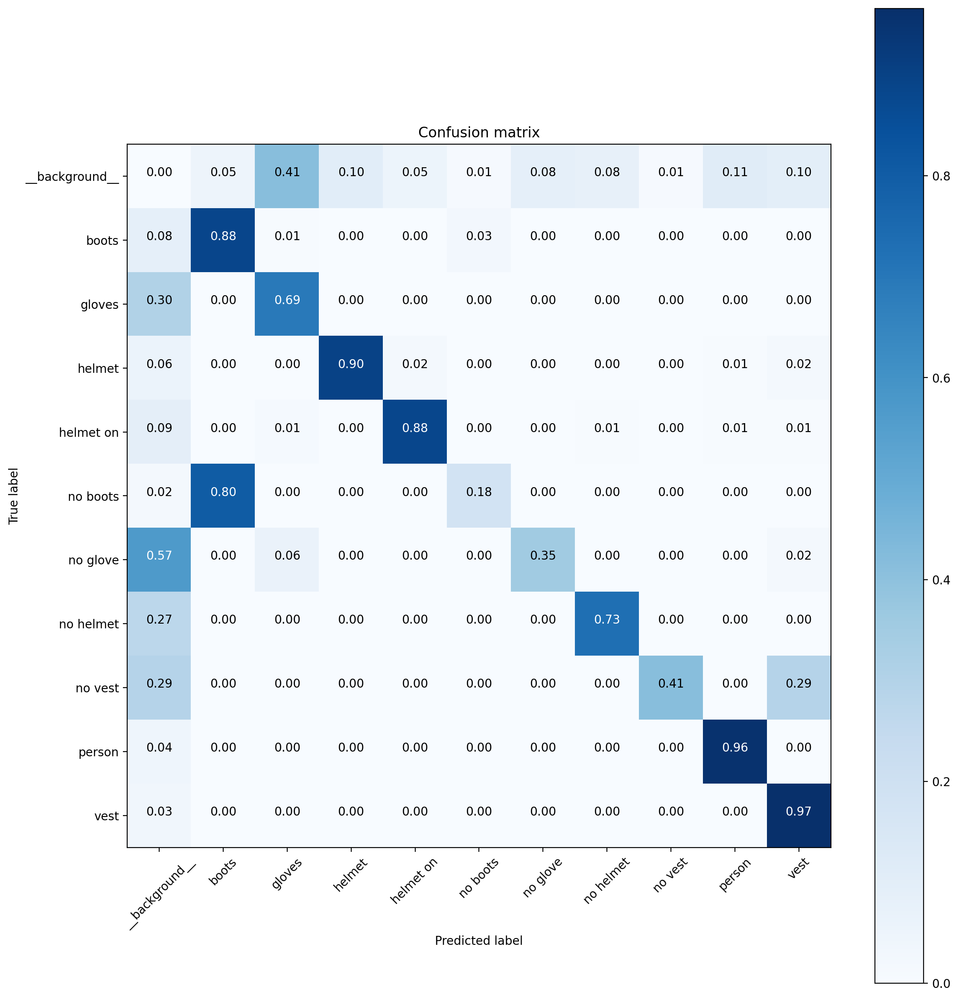

In [ ]:
import numpy as np
import seaborn as sns
from sklearn.metrics import confusion_matrix
import itertools

def calculate_confusion_matrix(ground_truths, predictions, class_names, iou_threshold=0.5):
    all_gt_labels = []
    all_pred_labels = []

    for gt, pred in zip(ground_truths, predictions):
        gt_boxes = gt['boxes']
        gt_labels = gt['labels']
        pred_boxes = pred['boxes']
        pred_labels = pred['labels']
        pred_scores = pred['scores']

        # Match ground truth with predictions
        matched_gt = set()
        matched_pred = set()

        for i, gt_box in enumerate(gt_boxes):
            gt_label = gt_labels[i]
            best_iou = 0
            best_j = -1

            for j, pred_box in enumerate(pred_boxes):
                if j in matched_pred:
                    continue

                iou = calculate_iou(gt_box, pred_box)
                if iou > best_iou:
                    best_iou = iou
                    best_j = j

            if best_iou >= iou_threshold:
                matched_gt.add(i)
                matched_pred.add(best_j)
                all_gt_labels.append(gt_label)
                all_pred_labels.append(pred_labels[best_j])
            else:
                all_gt_labels.append(gt_label)
                all_pred_labels.append(0)

        for j, pred_box in enumerate(pred_boxes):
            if j not in matched_pred:
                all_gt_labels.append(0)
                all_pred_labels.append(pred_labels[j])

    # Create confusion matrix
    cm = confusion_matrix(all_gt_labels, all_pred_labels, labels=range(len(class_names)))
    return cm

def plot_confusion_matrix(cm, class_names, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    plt.figure(figsize=(12, 12))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=45)
    plt.yticks(tick_marks, class_names)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.grid(False)

# Calculate the confusion matrix
cm = calculate_confusion_matrix(ground_truths, predictions, CUSTOM_CLASS_NAMES)

# Plot the confusion matrix
plot_confusion_matrix(cm, CUSTOM_CLASS_NAMES, normalize=True)

plt.show()


The classifier performs well in detecting "boots," "helmet," "helmet on," "person," and "vest," with high accuracy for these classes. However, it struggles with distinguishing "no boots," "no glove," "no helmet," and "no vest," showing significant confusion with the "background" class. The high confusion in certain classes indicates areas for potential improvement in the model's training or data preprocessing.




After that we decided to look at the number of labels presented in the dataset and we see the following distribution:

{'boots': 1027, 'gloves': 922, 'helmet': 536, 'helmet on': 557, 'no boots': 94, 'no glove': 217, 'no helmet': 224, 'no vest': 36, 'person': 814, 'vest': 868}


<ipython-input-30-178f99cb5de6>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=counts, palette="viridis")


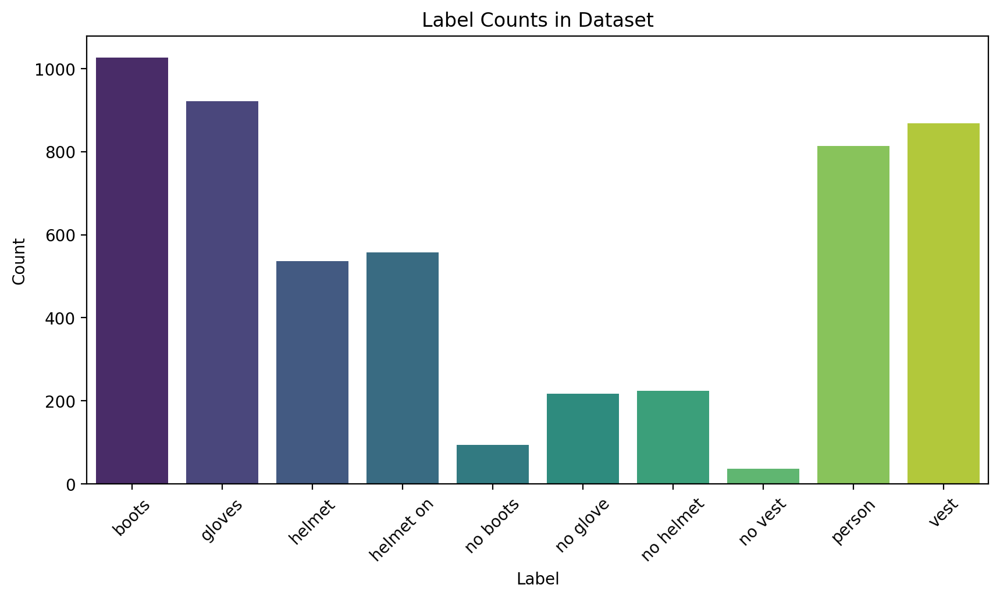

In [ ]:
dataset = CustomDataset(root='/content/drive/My Drive/construction.v1i.voc/train', transforms=get_transform())

# Function to count labels
def count_labels(dataset):
    label_counts = {label: 0 for label in CUSTOM_CLASS_NAMES[1:]}  # Initialize counts for each label

    for img, target in dataset:
        labels = target['labels'].numpy()
        for label in labels:
            label_name = CUSTOM_CLASS_NAMES[label]
            if label_name in label_counts:
                label_counts[label_name] += 1

    return label_counts

# Count the labels in the dataset
label_counts = count_labels(dataset)
print(label_counts)

# Visualize the label counts on a graph
def plot_label_counts(label_counts):
    labels = list(label_counts.keys())
    counts = list(label_counts.values())

    plt.figure(figsize=(10, 5))
    sns.barplot(x=labels, y=counts, palette="viridis")
    plt.xlabel('Label')
    plt.ylabel('Count')
    plt.title('Label Counts in Dataset')
    plt.xticks(rotation=45)
    plt.grid(False)
    plt.show()

plot_label_counts(label_counts)

No Boots and No Vest are the least represented labels, with fewer than 200 instances each.
No Glove and No Helmet have moderate representation, each with around 300 to 400 instances.
Person and Vest labels are well-represented, each with around 800 instances.
This imbalance in the dataset could explain some of the classifier's performance issues, especially for the underrepresented classes like "No Boots" and "No Vest."

**Conclusion**

Our project successfully developed a deep learning-based system for automated detection of Personal Protective Equipment (PPE) using the Faster R-CNN model. The system showed high accuracy in detecting well-represented PPE classes but struggled with underrepresented ones. By addressing data imbalance and improving model training techniques, the system's performance can be further enhanced, ensuring reliable and efficient safety compliance monitoring in various environments.